In [1]:
!pip install pandas
import numpy as np
import matplotlib.pyplot as plt
import glob
%matplotlib inline 

from skimage import io, color, filters, feature, restoration
from skimage.transform import resize, rotate
from skimage.color import rgb2gray
from scipy.spatial.distance import squareform
from scipy.misc import imread
import pandas as pd
import matplotlib.cm as cm
from scipy import ndimage, misc
import pickle

import sys
sys.path.append("..")

You are using pip version 19.0.3, however version 19.3.1 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.


In [2]:
from src.standardizer import Standardizer
from src.imageData_generator import ImageGenerator

In [3]:
resized_imgs = glob.glob('../data/medium/*')

In [4]:

img_list = [164, 202, 425, 345, 139, 72, 311, 363, 403, 509, 362, 257, 175, 203, 47, 183, 0, 297, 34, 8, 320, 197, 293, 450, 215, 28, 74]

In [5]:
img_subset = []
for img in resized_imgs:
    img_idx = int(img.split('/')[3].split('_')[0])
    if img_idx in img_list:
        img_subset.append(img)

In [6]:
standardizer_subset = Standardizer(img_subset, resized_imgs[3])

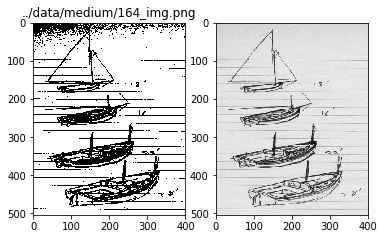

(504, 400)


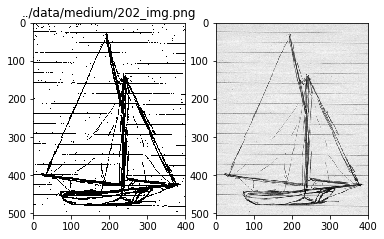

(504, 400)


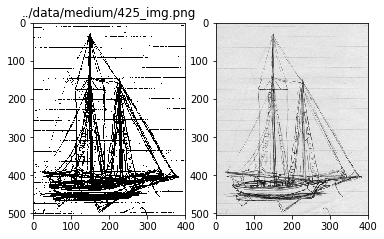

(504, 400)


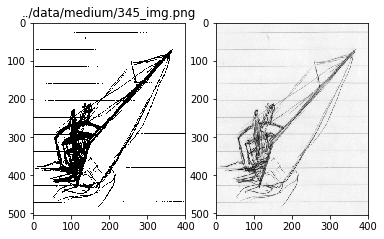

(504, 400)


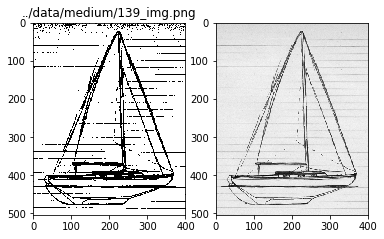

(504, 400)


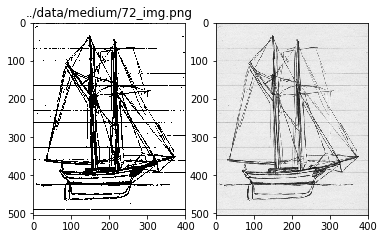

(504, 400)


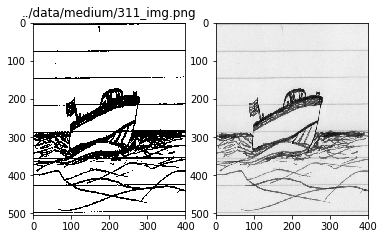

(504, 400)


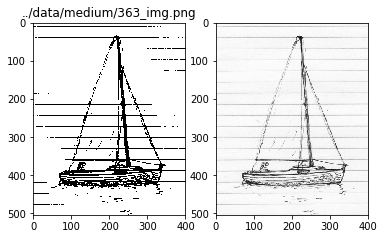

(504, 400)


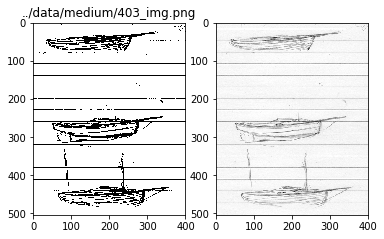

(504, 400)


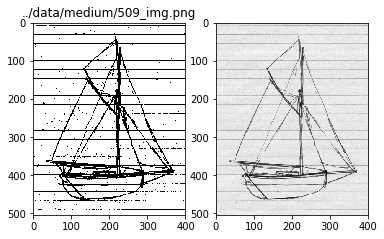

(504, 400)


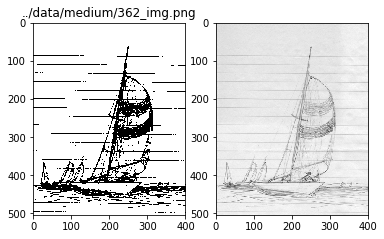

(504, 400)


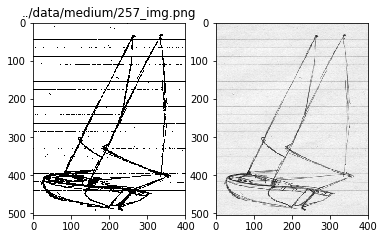

(504, 400)


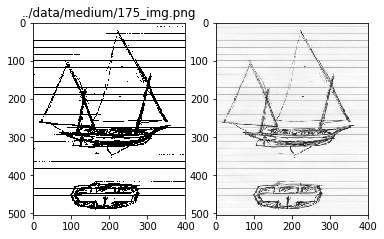

(504, 400)


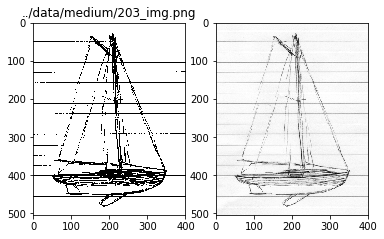

(504, 400)


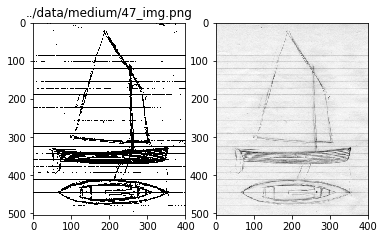

(504, 400)


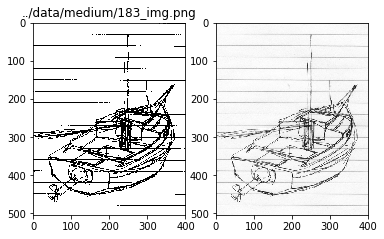

(504, 400)


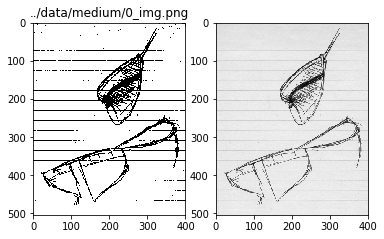

(504, 400)


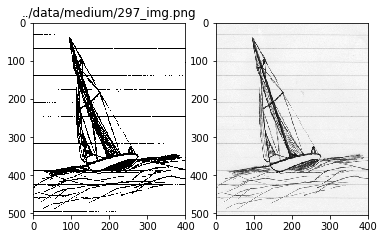

(504, 400)


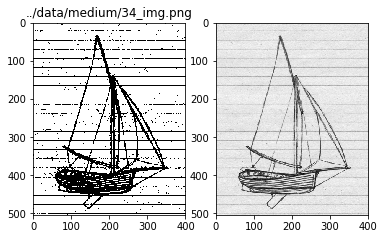

(504, 400)


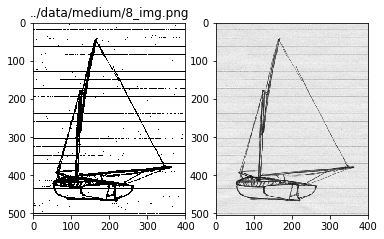

(504, 400)


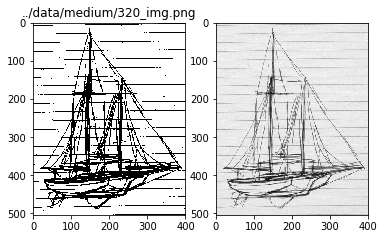

(504, 400)


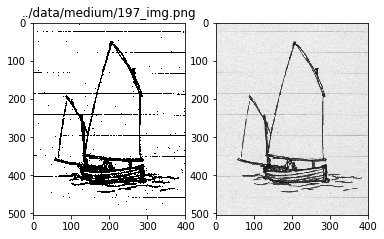

(504, 400)


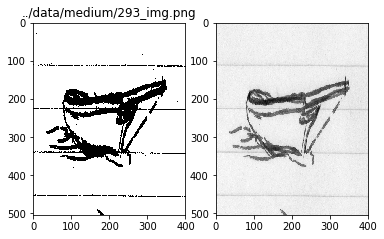

(504, 400)


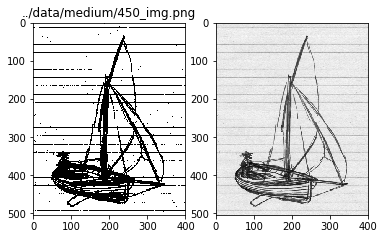

(504, 400)


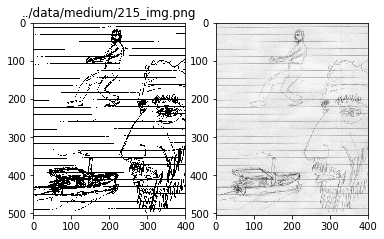

(504, 400)


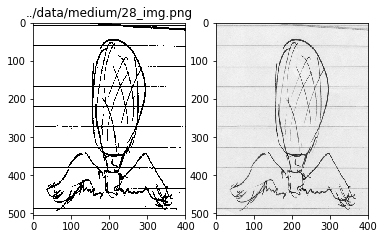

(504, 400)


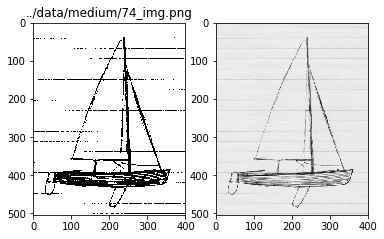

(504, 400)


In [7]:
for i in range(len(img_subset)):
    fig, ax = plt.subplots(1, 2)
    ax[0].imshow(standardizer_subset.binarized_images[i], cmap='gray')
    ax[1].imshow(standardizer_subset.greyscale_image_list[i], cmap='gray')
    ax[0].set_title(standardizer_subset.image_list[i])
    plt.show()
    print(standardizer_subset.greyscale_image_list[i].shape)

In [8]:
bin_image = standardizer_subset.binarized_images[15]
grey_image = standardizer_subset.greyscale_image_list[15]
img_name = standardizer_subset.image_list[15].split('/')[3].split('.')[0]


In [9]:
len(standardizer_subset.greyscale_image_list)

27

Whitespace


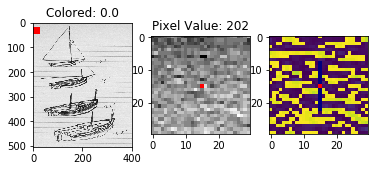

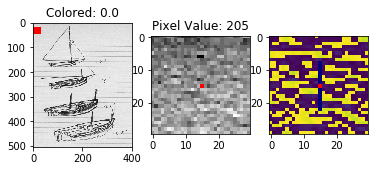

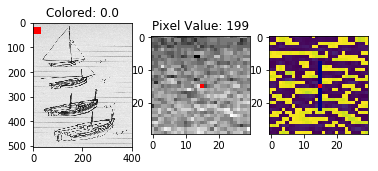

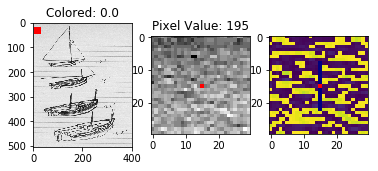

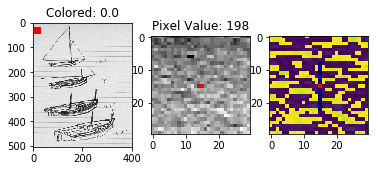

...

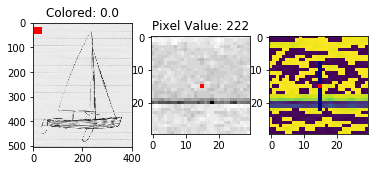

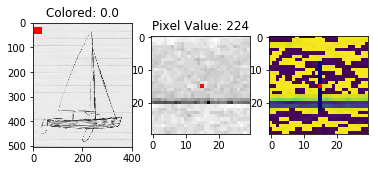

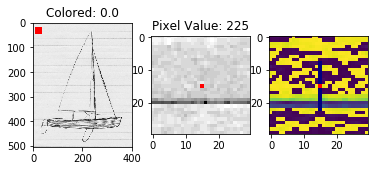

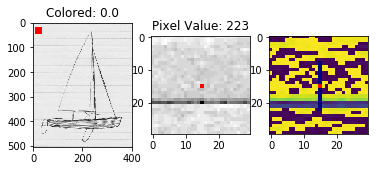

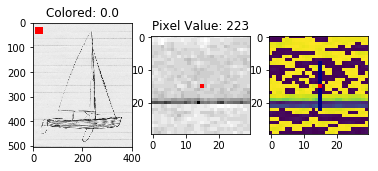

In [14]:
row_idx = 20
whitespace = []
for j in range(27):
    image = standardizer_subset.greyscale_image_list[j]
    sub = []
    for i in range(10):
        plot_frame(image, row_idx, i, 30)
        plt.show()
        window = image[row_idx: row_idx+30, i: i+30]
        pixel_value = window[15, 15]
        sub.append(pixel_value)
    whitespace.append(sub)

In [15]:
whitespace_mean = np.array([np.mean(i) for i in whitespace])

In [16]:
whitespace_mean

array([200.2, 200.5, 208. , 237.4, 201.6, 216.2, 238.7, 247.7, 251.4,
       207.9, 225.8, 201.2, 248.9, 250.8, 246.3, 252.4, 205.6, 239.6,
       207.9, 205.3, 202. , 217.2, 219.9, 202.2, 242.2, 229.3, 224.1])

Will average whitespace intensity (general shade of the image) impact classification/CNN models? We will see
- if it does: create different models for different shade groups

In [10]:
images = ImageGenerator(bin_image, grey_image, img_name)
images.pad(15, 230)

In [11]:
gray = images.gray_padded_image
binar = images.bin_padded_image

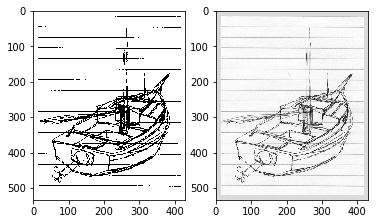

In [12]:
fig, ax = plt.subplots(1, 2)
ax[0].imshow(binar, cmap='gray')
ax[1].imshow(gray, cmap='gray')

In [13]:
for i, a in enumerate(standardizer_subset.image_list):
    print(i, a)

0 ../data/medium/164_img.png
1 ../data/medium/202_img.png
2 ../data/medium/425_img.png
3 ../data/medium/345_img.png
4 ../data/medium/139_img.png
5 ../data/medium/72_img.png
6 ../data/medium/311_img.png
7 ../data/medium/363_img.png
8 ../data/medium/403_img.png
9 ../data/medium/509_img.png
10 ../data/medium/362_img.png
11 ../data/medium/257_img.png
12 ../data/medium/175_img.png
13 ../data/medium/203_img.png
14 ../data/medium/47_img.png
15 ../data/medium/183_img.png
16 ../data/medium/0_img.png
17 ../data/medium/297_img.png
18 ../data/medium/34_img.png
19 ../data/medium/8_img.png
20 ../data/medium/320_img.png
21 ../data/medium/197_img.png
22 ../data/medium/293_img.png
23 ../data/medium/450_img.png
24 ../data/medium/215_img.png
25 ../data/medium/28_img.png
26 ../data/medium/74_img.png


In [14]:
for i, a in enumerate([200.2, 200.5, 208. , 237.4, 201.6, 216.2, 238.7, 247.7, 251.4,
       207.9, 225.8, 201.2, 248.9, 250.8, 246.3, 252.4, 205.6, 239.6,
       207.9, 205.3, 202. , 217.2, 219.9, 202.2, 242.2, 229.3, 224.1]):
    print(i, a)

0 200.2
1 200.5
2 208.0
3 237.4
4 201.6
5 216.2
6 238.7
7 247.7
8 251.4
9 207.9
10 225.8
11 201.2
12 248.9
13 250.8
14 246.3
15 252.4
16 205.6
17 239.6
18 207.9
19 205.3
20 202.0
21 217.2
22 219.9
23 202.2
24 242.2
25 229.3
26 224.1


In [15]:
whitespace_dict = {164: 200.2, 202: 200.5, 425: 208., 345: 237.4, 72: 216.2, 363: 247.7, 509: 207.9, 257: 201.2, 203: 250.8, 183: 252.4}

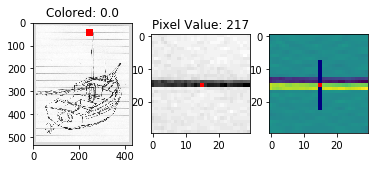

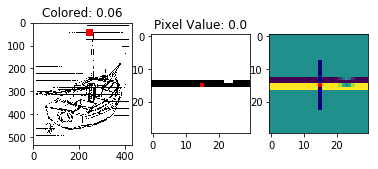


1


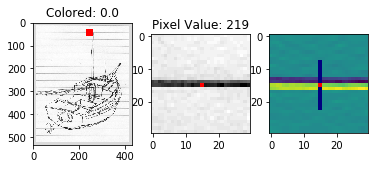

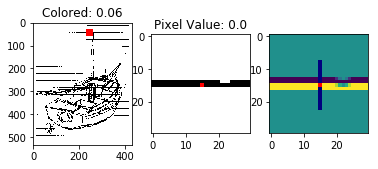


1


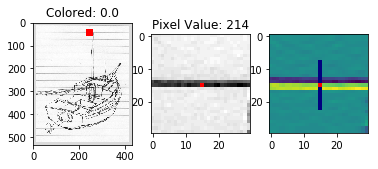

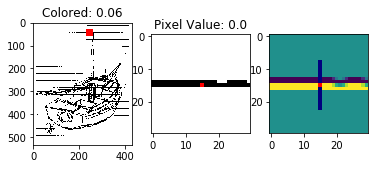


1


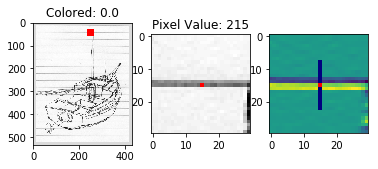

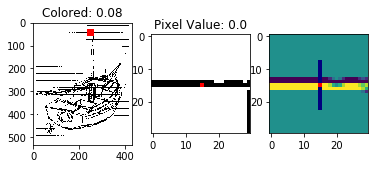


1


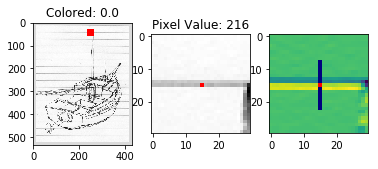

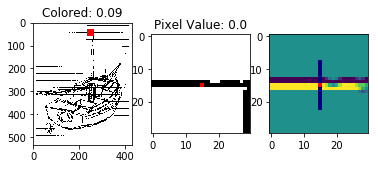


1


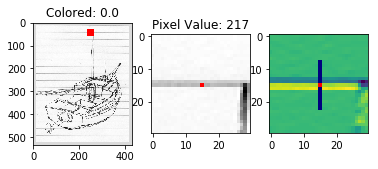

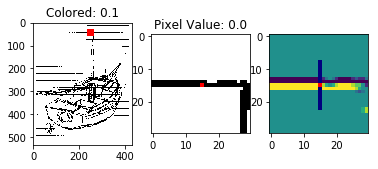


1


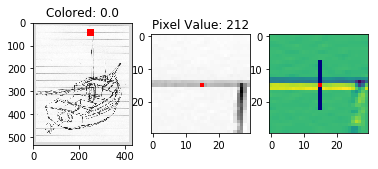

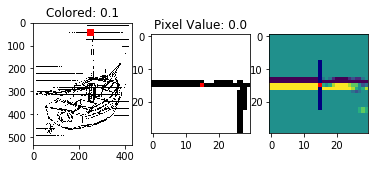


1


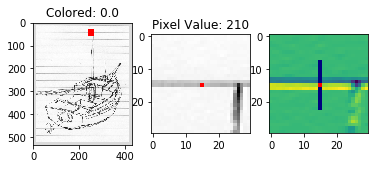

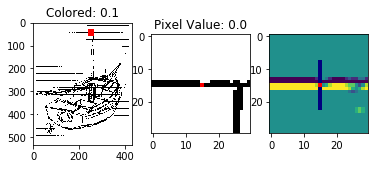


1


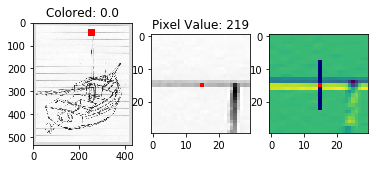

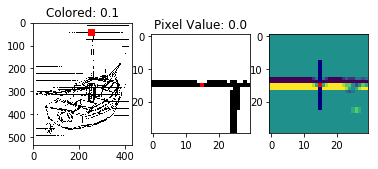


1


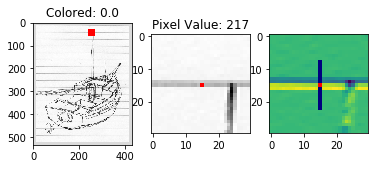

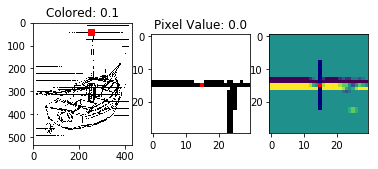


1


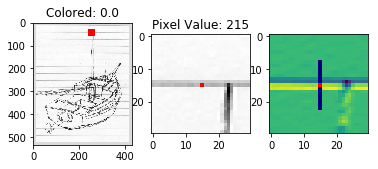

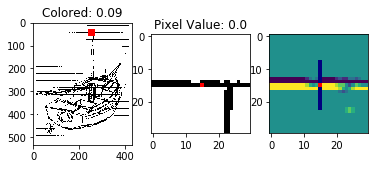


1


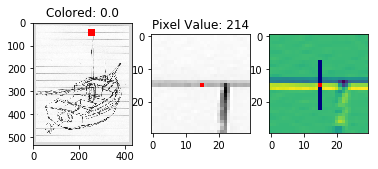

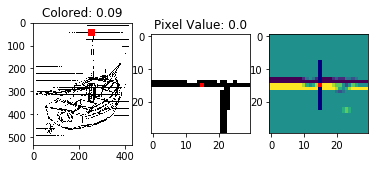


1


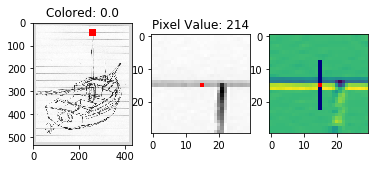

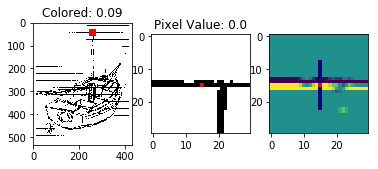


1


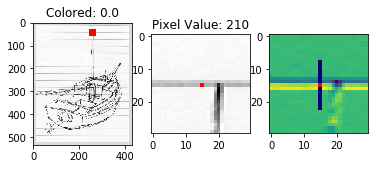

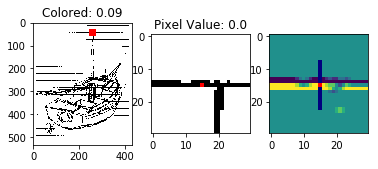


1


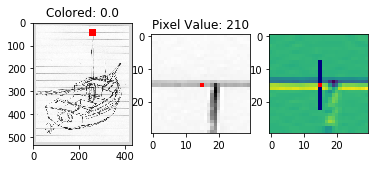

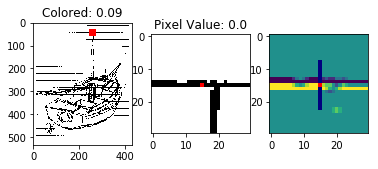


1


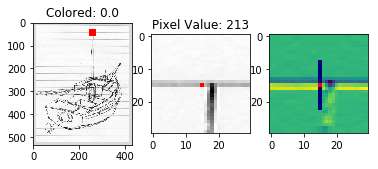

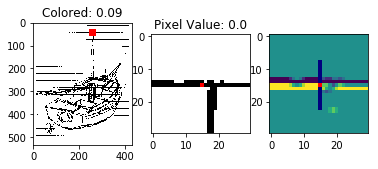


1


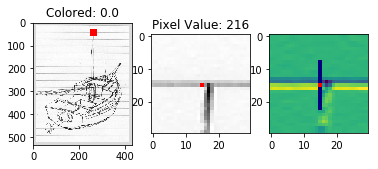

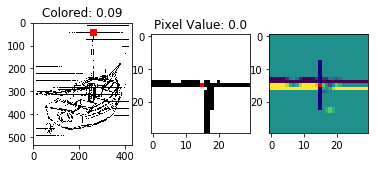


1


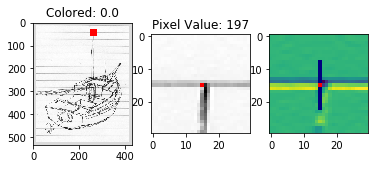

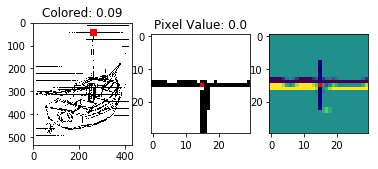

asdf
0


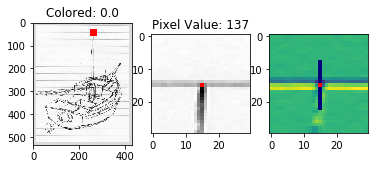

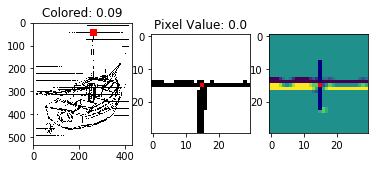

asdf
0


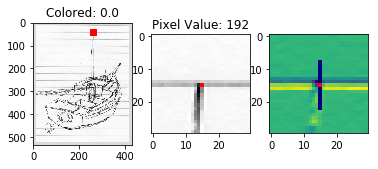

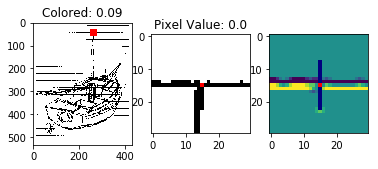

asdf
0


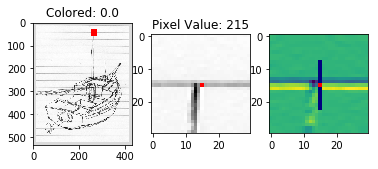

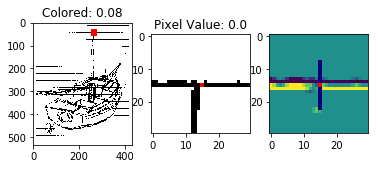


1


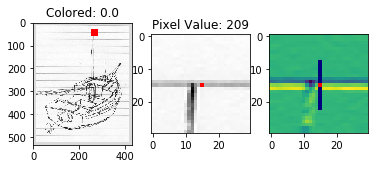

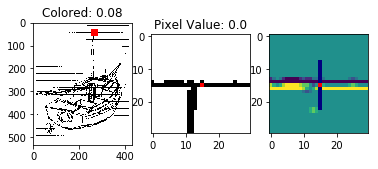


1


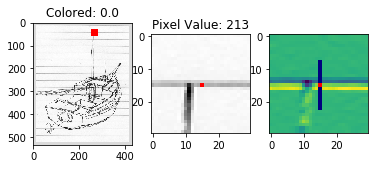

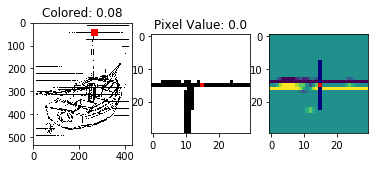


1


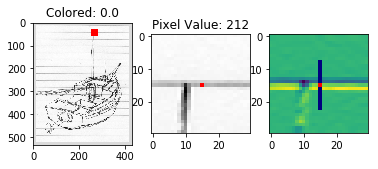

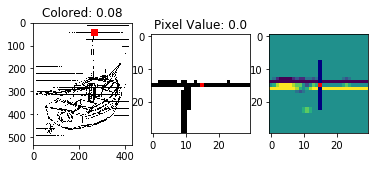


1


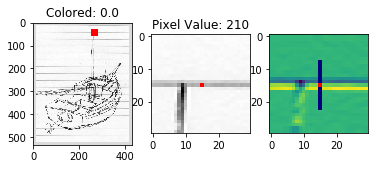

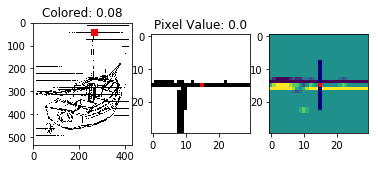


1


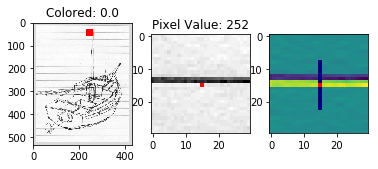

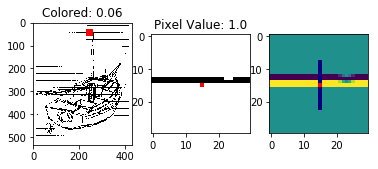

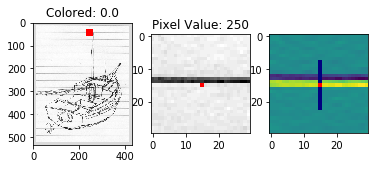

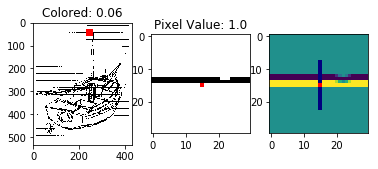

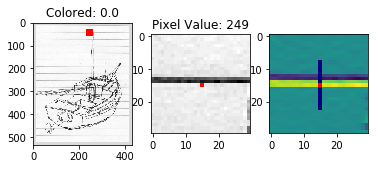

...

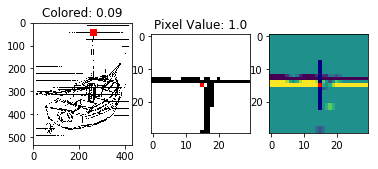

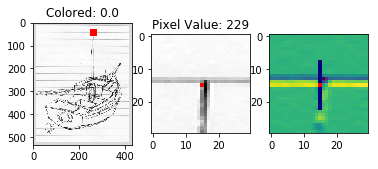

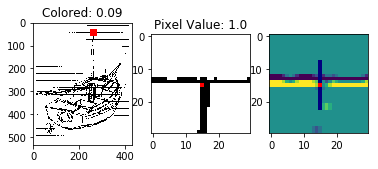

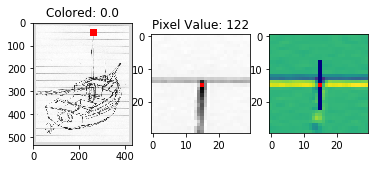

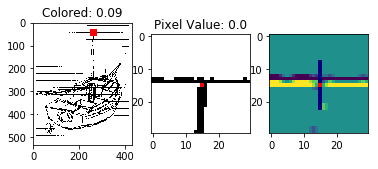

adfs
0


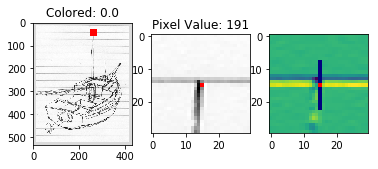

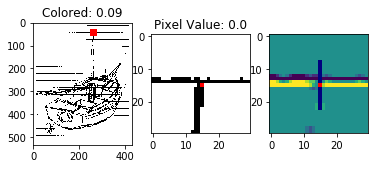

asdf
0


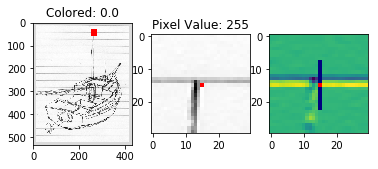

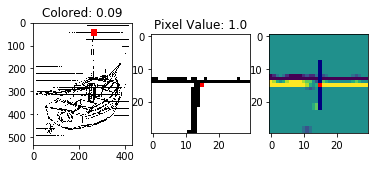

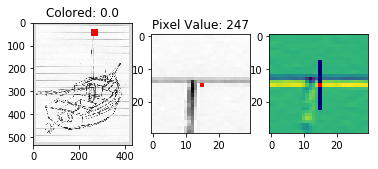

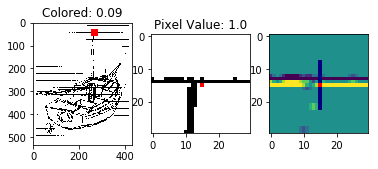

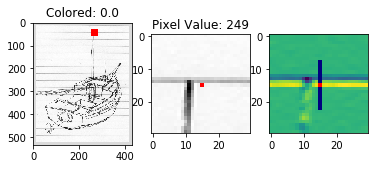

...

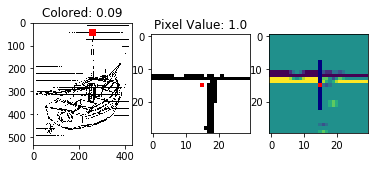

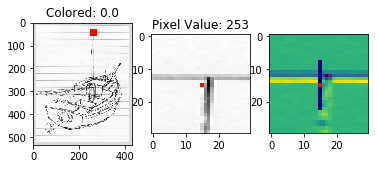

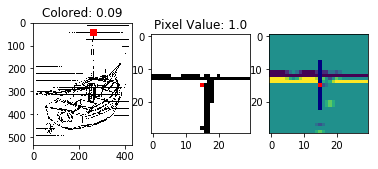

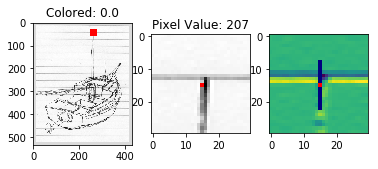

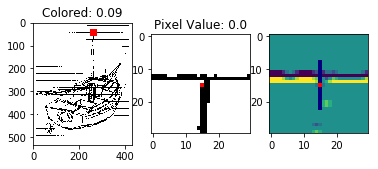

adsf
0


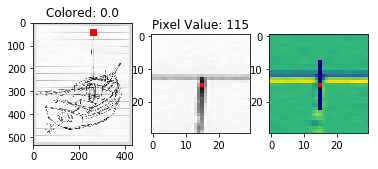

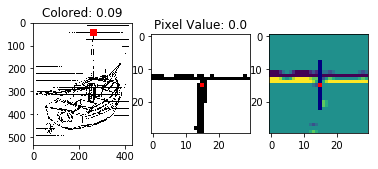

adf
0


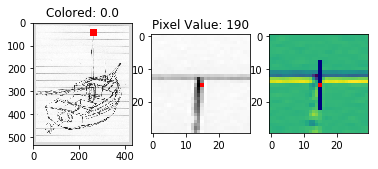

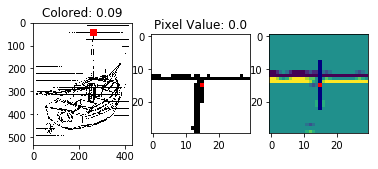

asdf
0


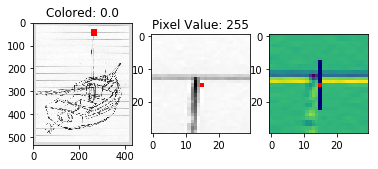

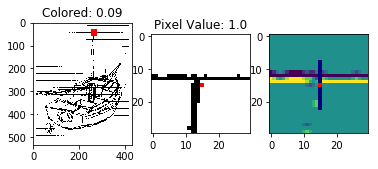

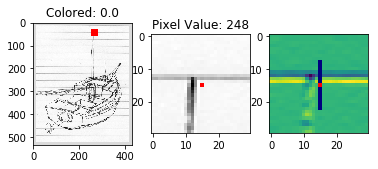

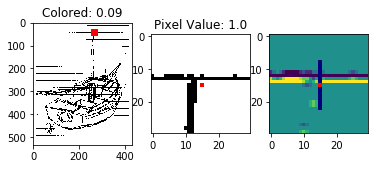

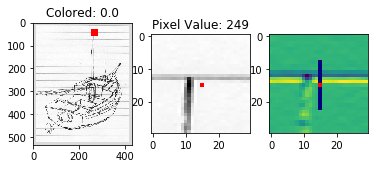

...

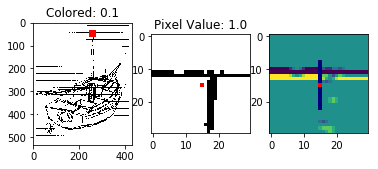

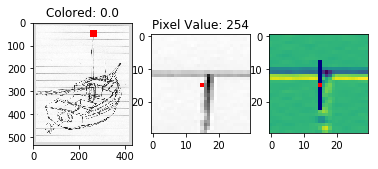

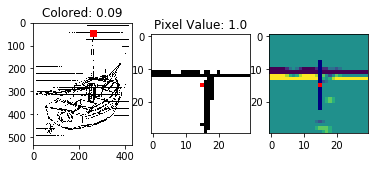

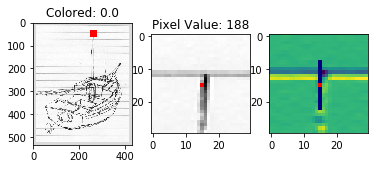

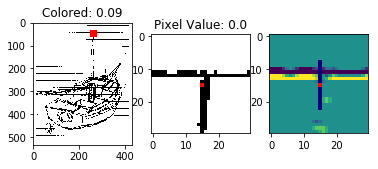

asdf
0


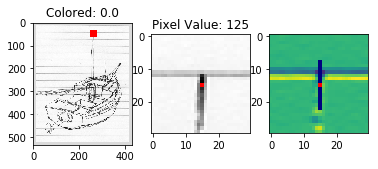

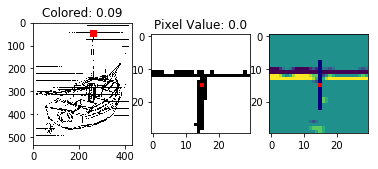

asdf
0


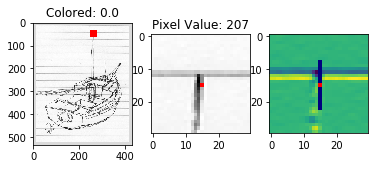

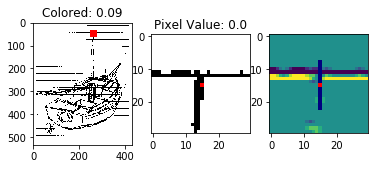

asdf
0


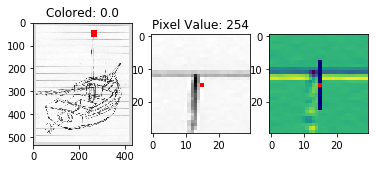

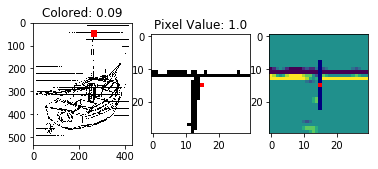

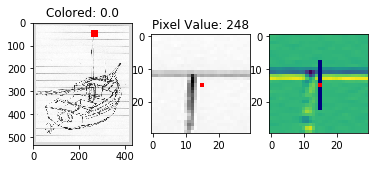

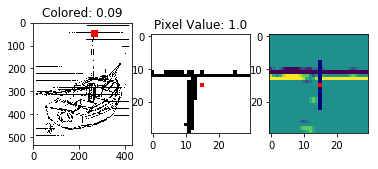

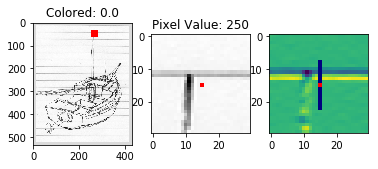

...

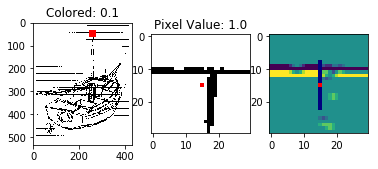

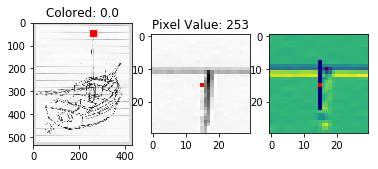

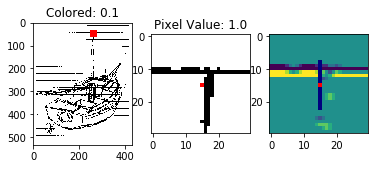

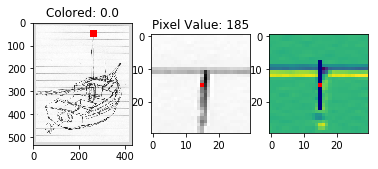

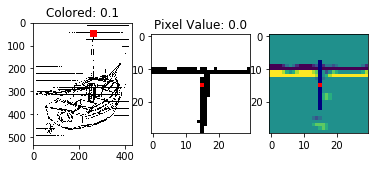

asdf
0


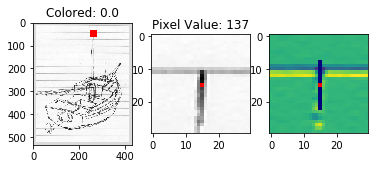

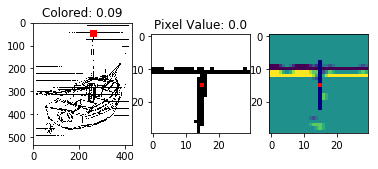

asdf
0


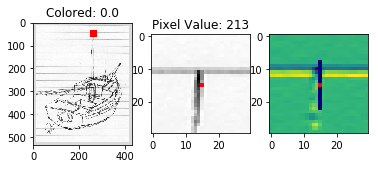

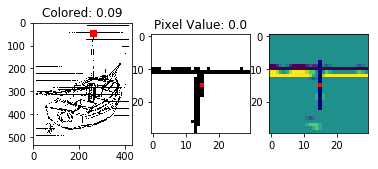

asdf
0


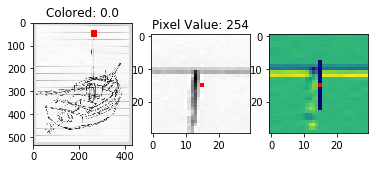

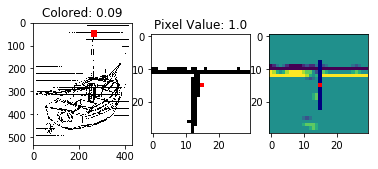

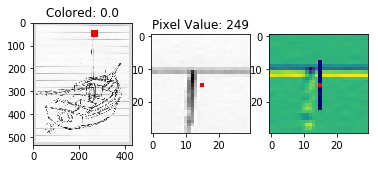

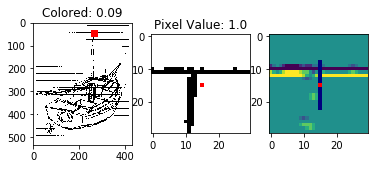

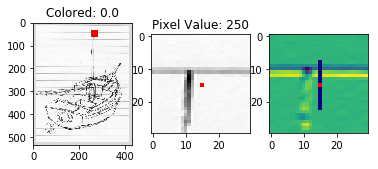

...

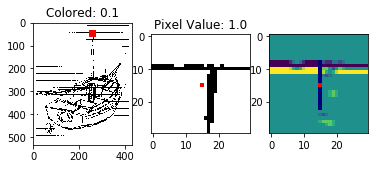

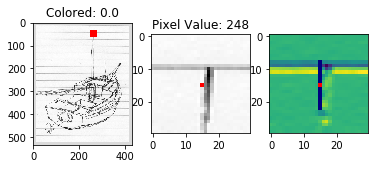

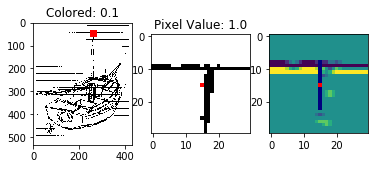

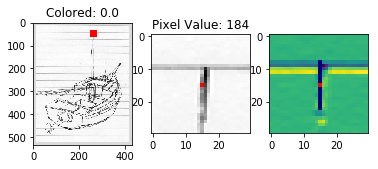

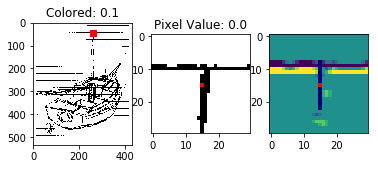

asdf
0


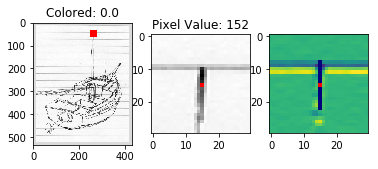

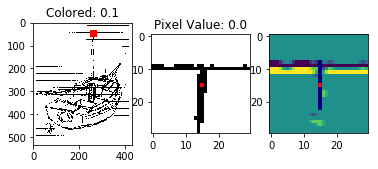

asdf
0


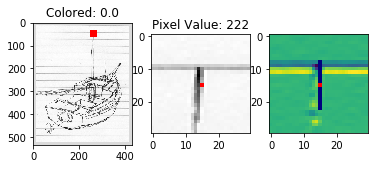

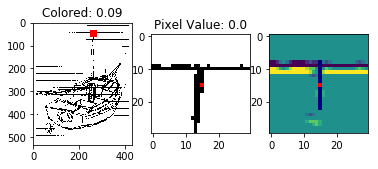

asdf
0


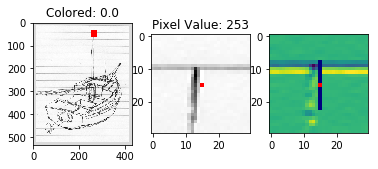

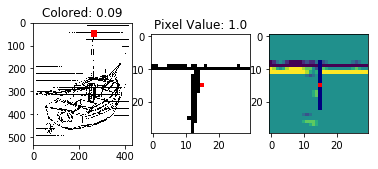

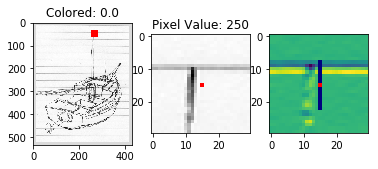

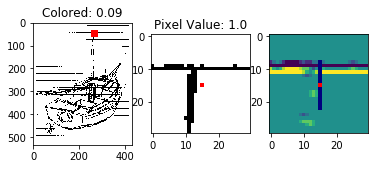

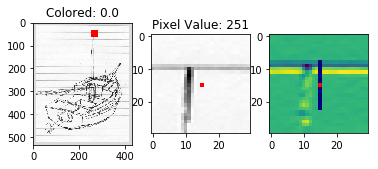

...

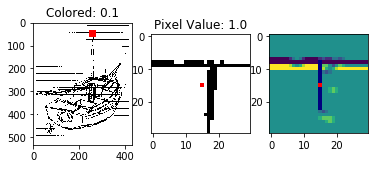

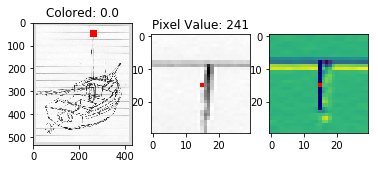

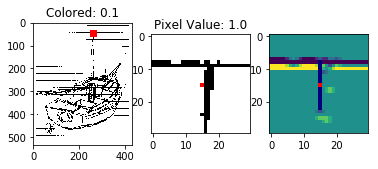

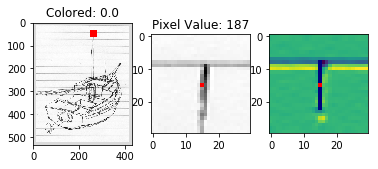

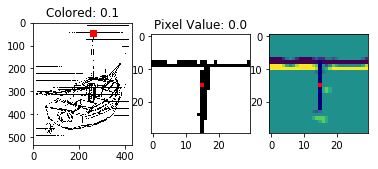

adsf
0


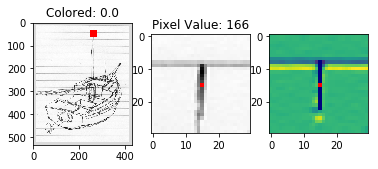

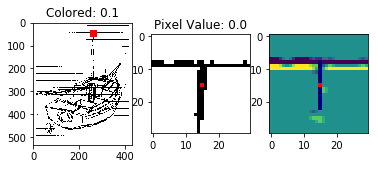

asdf
0


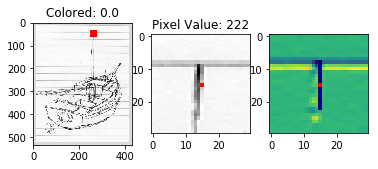

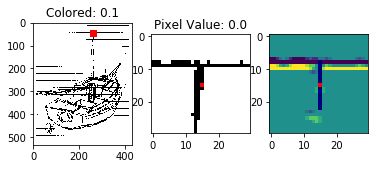

asdf
0


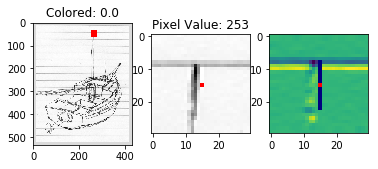

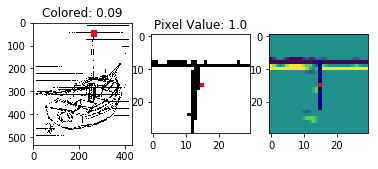

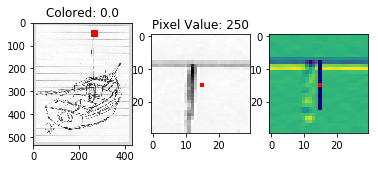

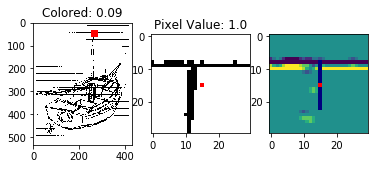

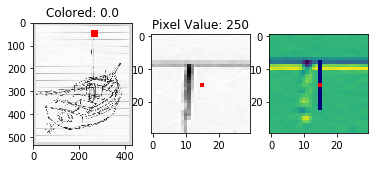

...

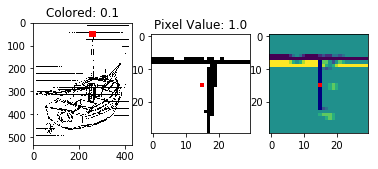

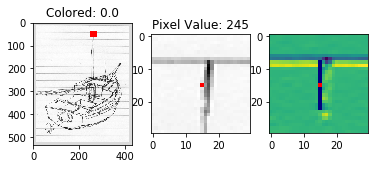

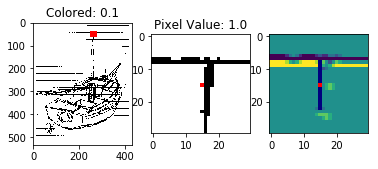

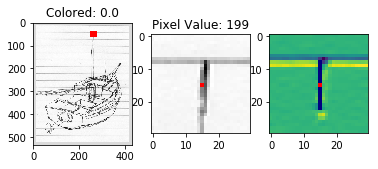

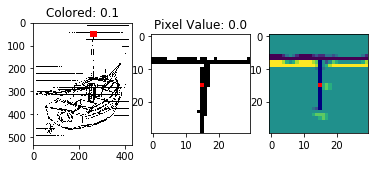

adsf
0


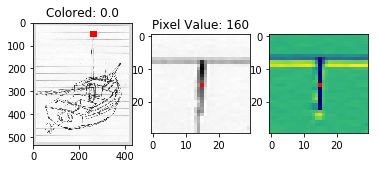

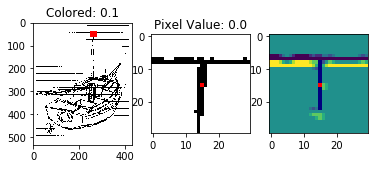

asdf
0


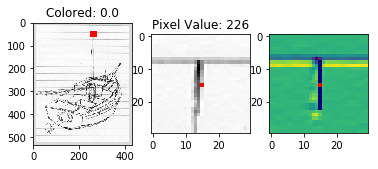

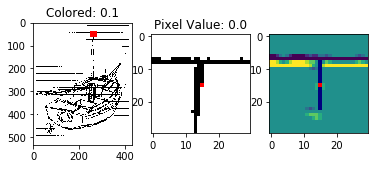

asdf
0


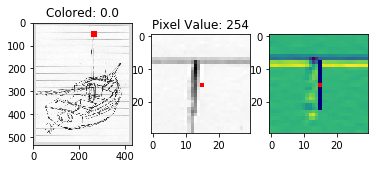

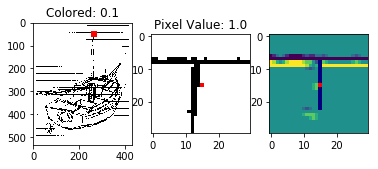

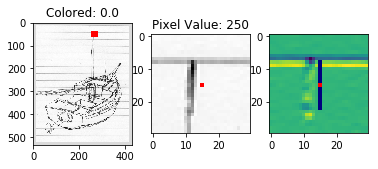

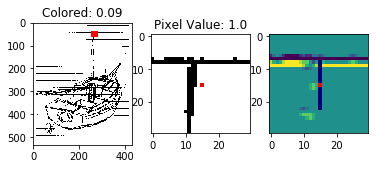

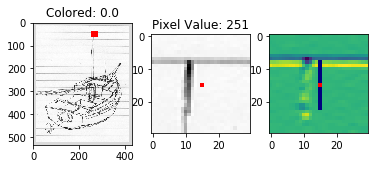

...

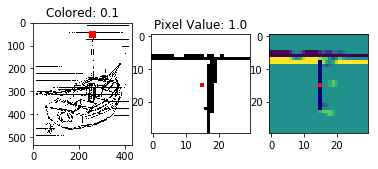

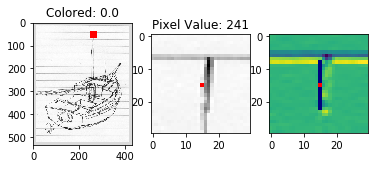

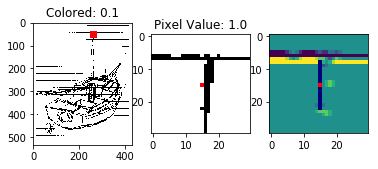

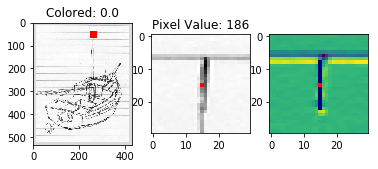

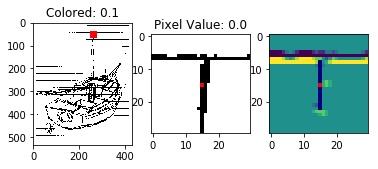

asef
0


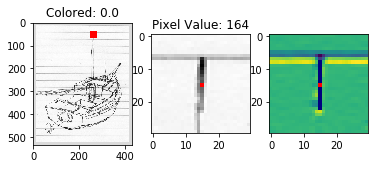

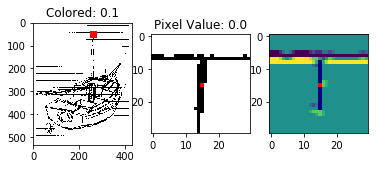

asdf
0


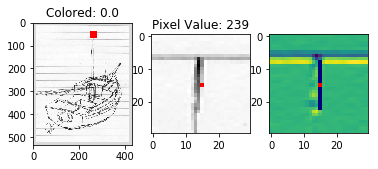

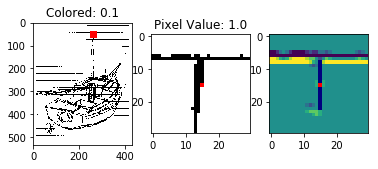

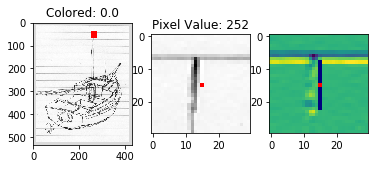

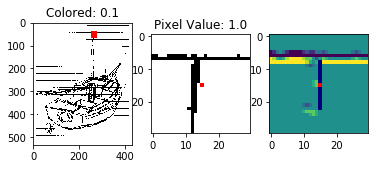

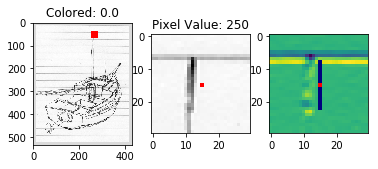

...

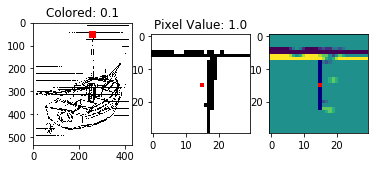

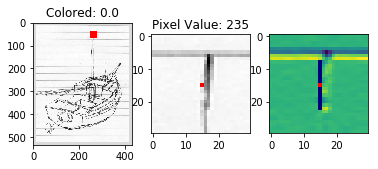

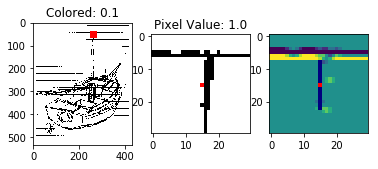

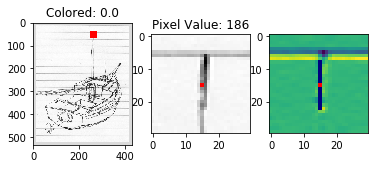

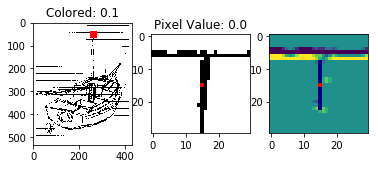

asdf
0


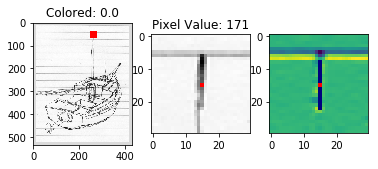

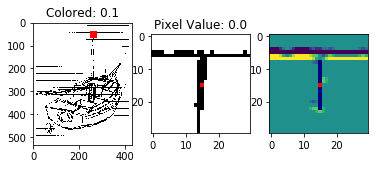

asdf
0


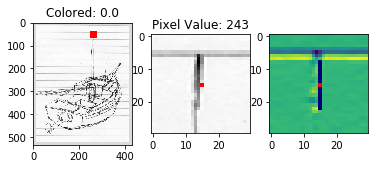

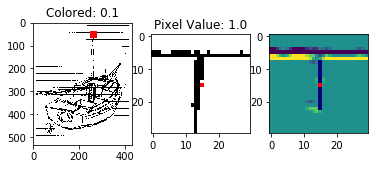

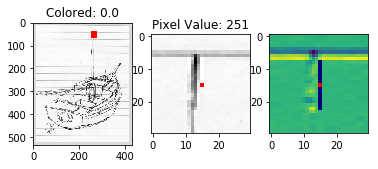

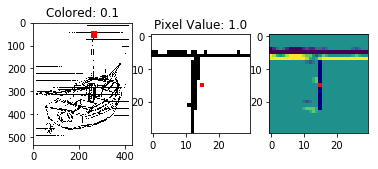

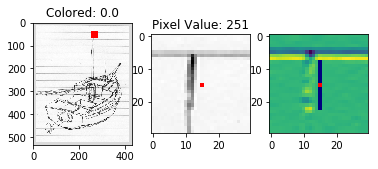

...

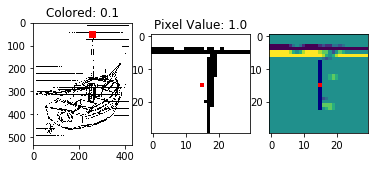

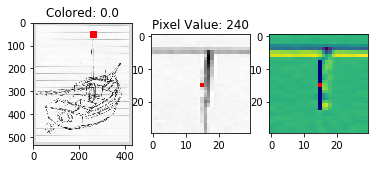

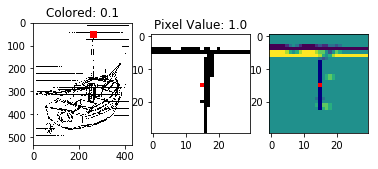

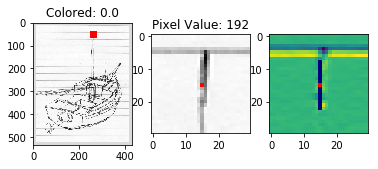

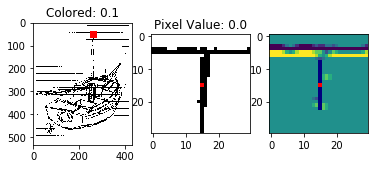

sadf
0


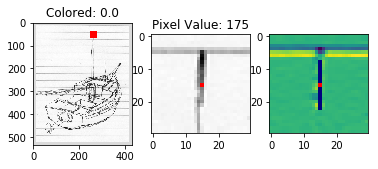

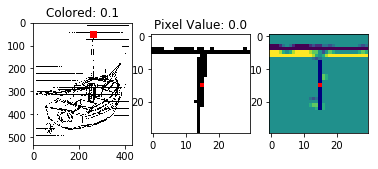

asdf
0


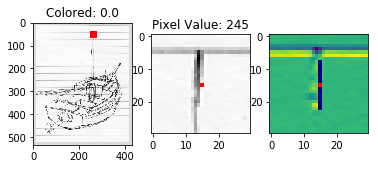

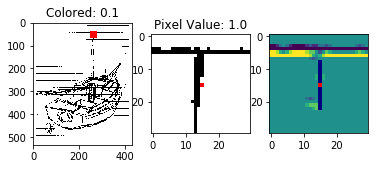

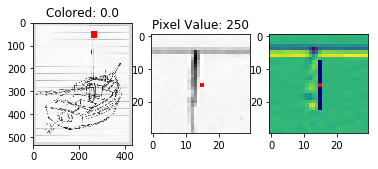

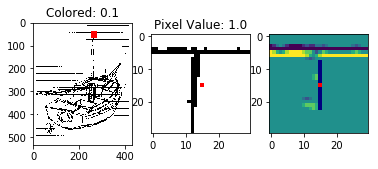

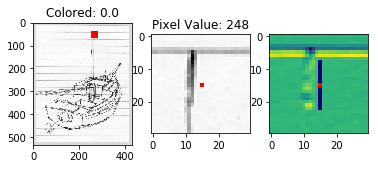

...

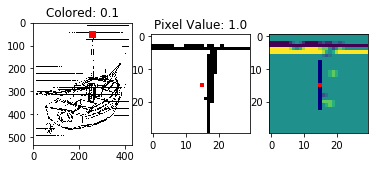

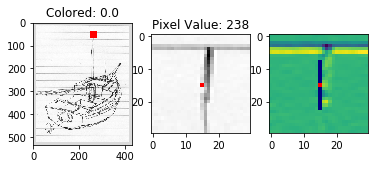

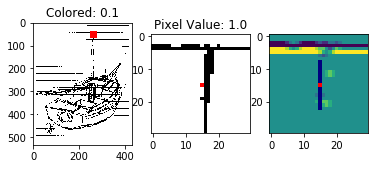

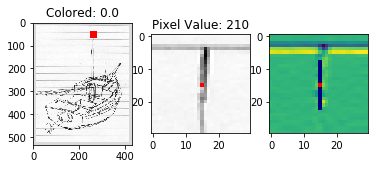

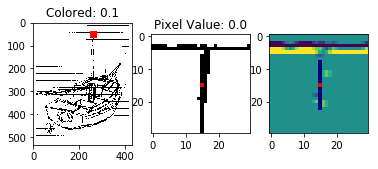

asdf
0


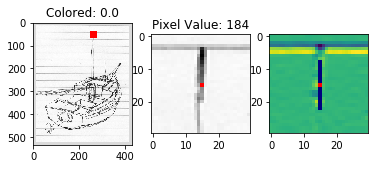

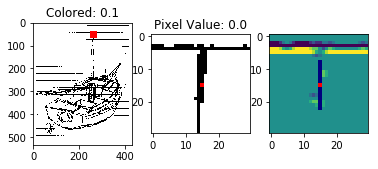

asdf
0


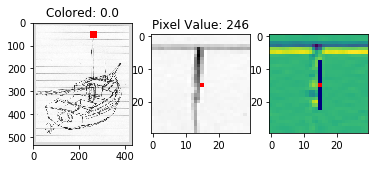

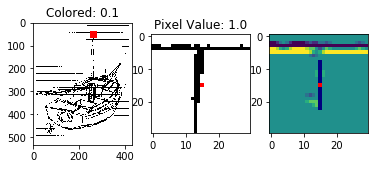

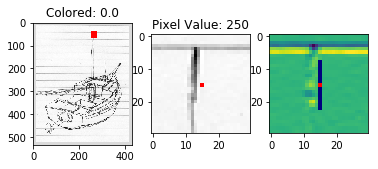

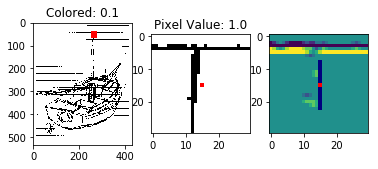

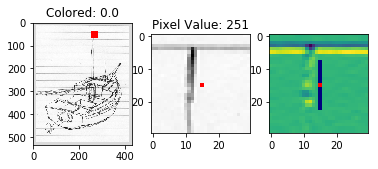

...

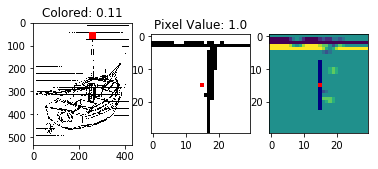

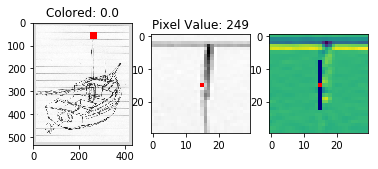

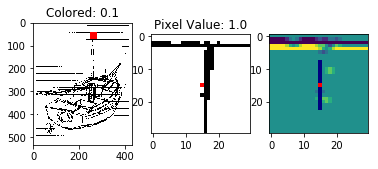

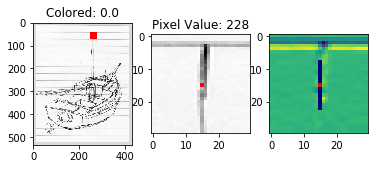

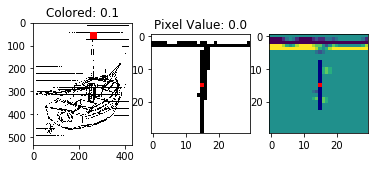

asdf
0


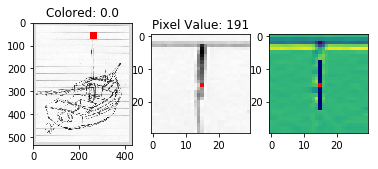

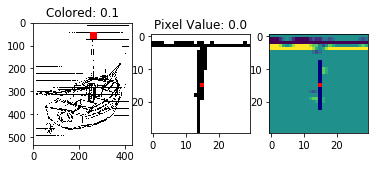

asdf
0


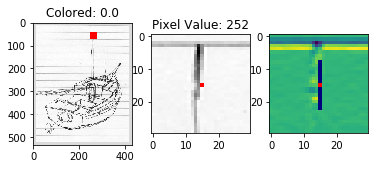

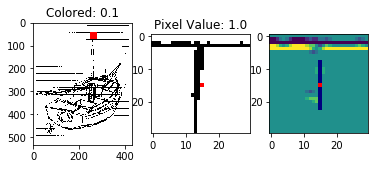

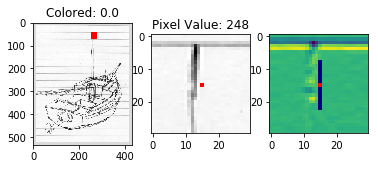

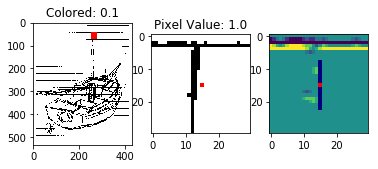

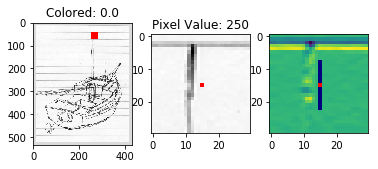

...

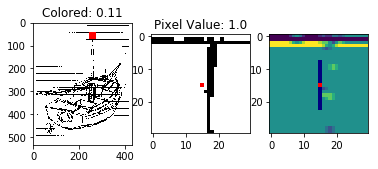

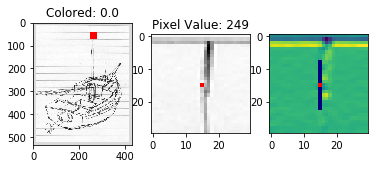

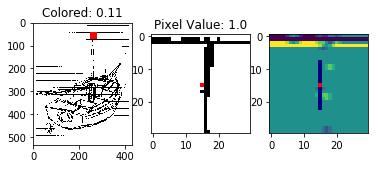

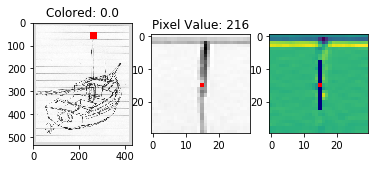

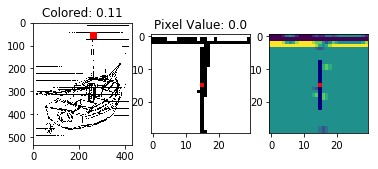

adsf
0


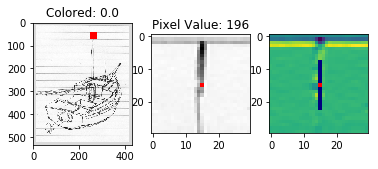

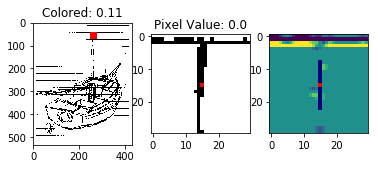

asdf
0


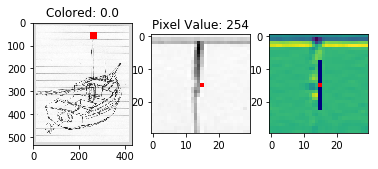

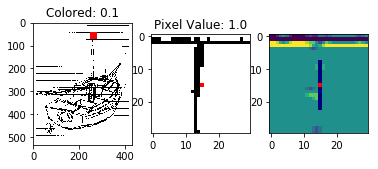

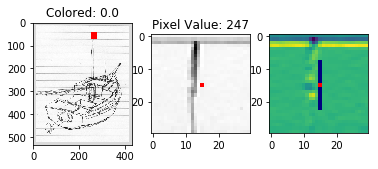

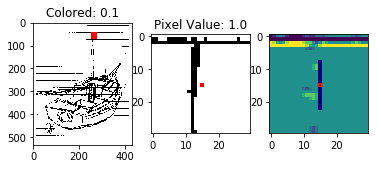

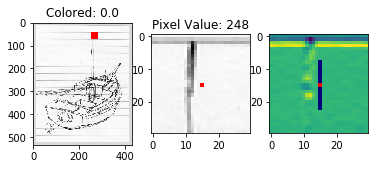

...

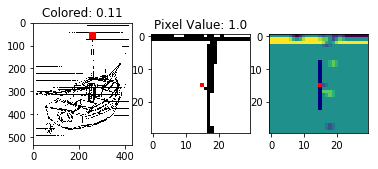

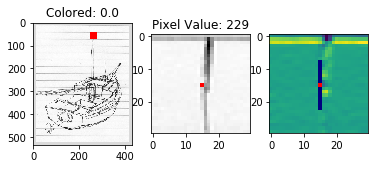

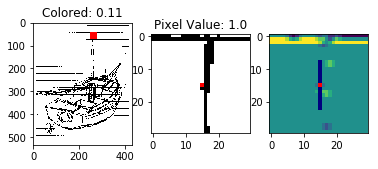

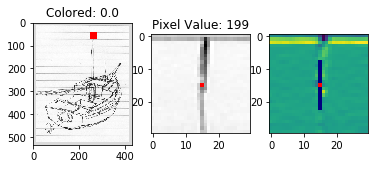

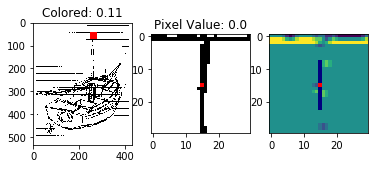

asdf
0


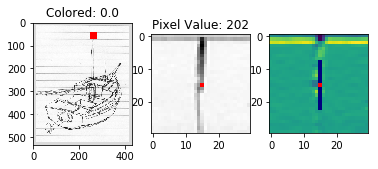

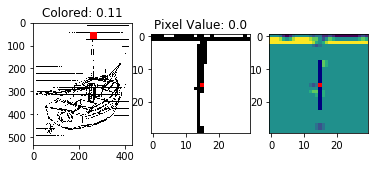

adsf
0


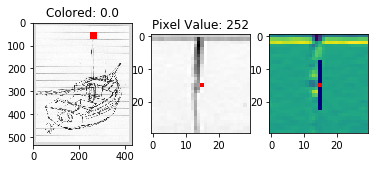

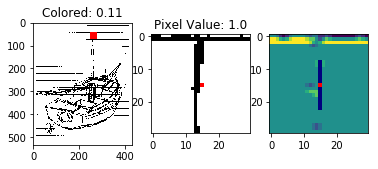

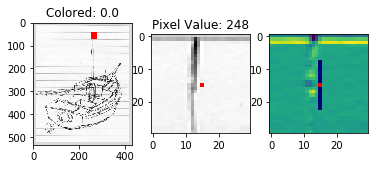

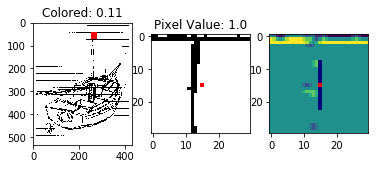

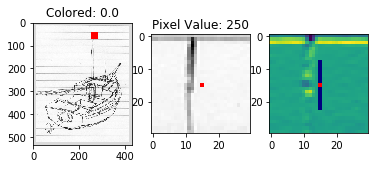

...

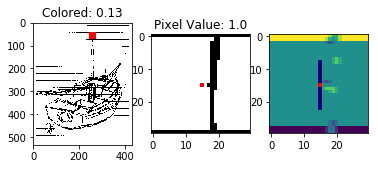

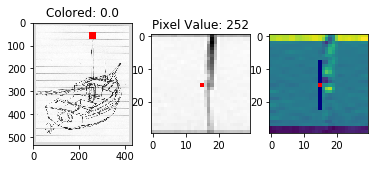

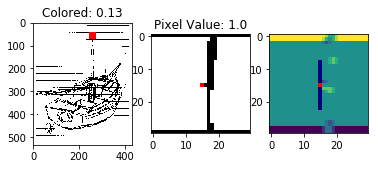

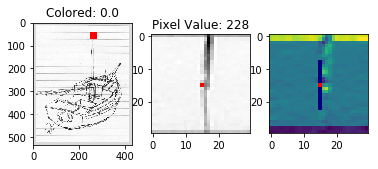

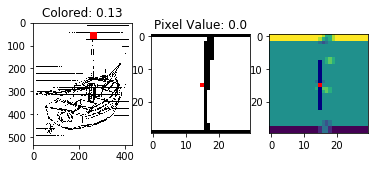

asdf
0


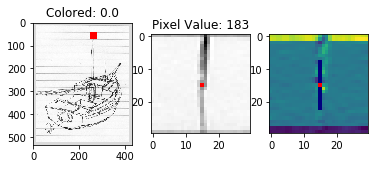

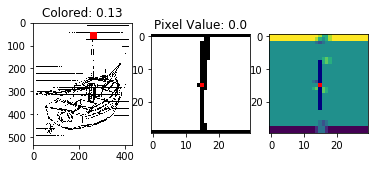

asdf
0


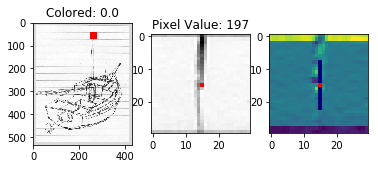

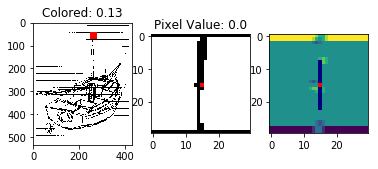

asdf
0


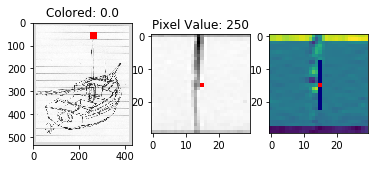

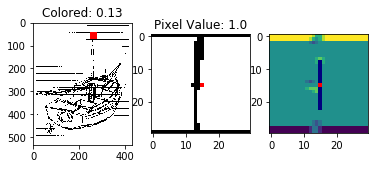

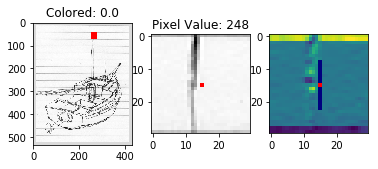

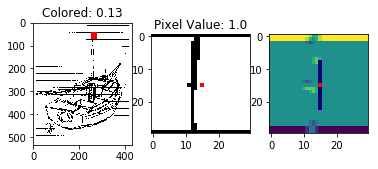

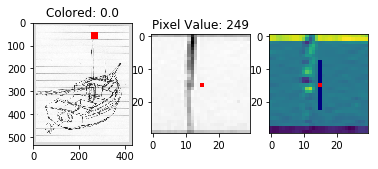

...

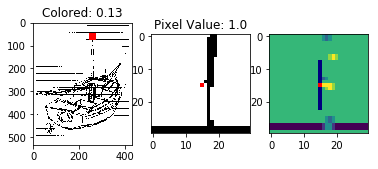

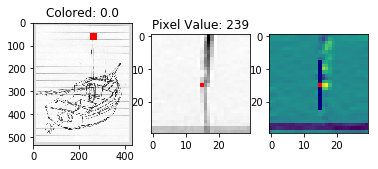

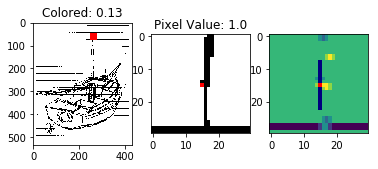

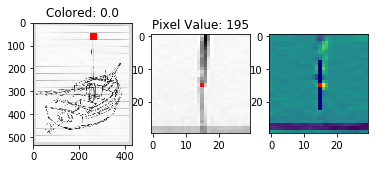

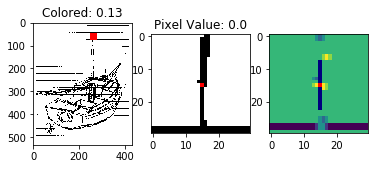

sadf
0


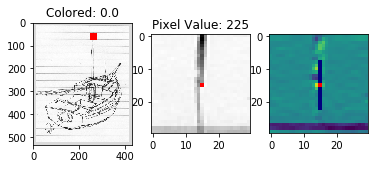

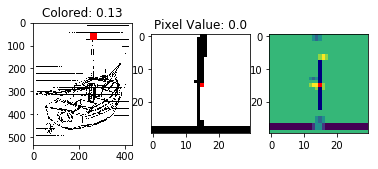

asdf
0


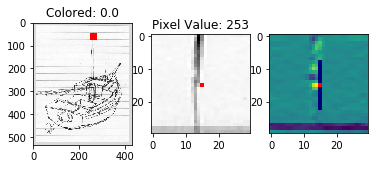

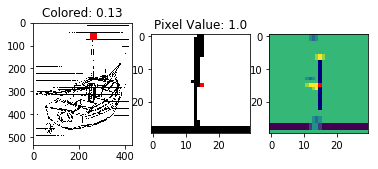

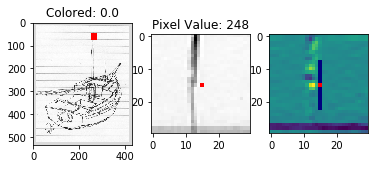

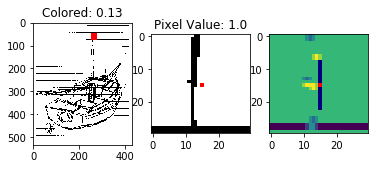

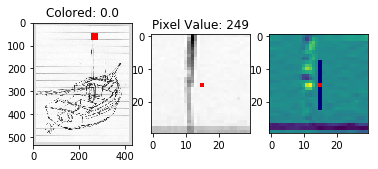

...

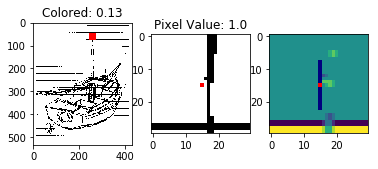

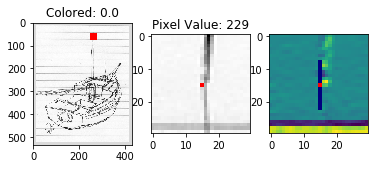

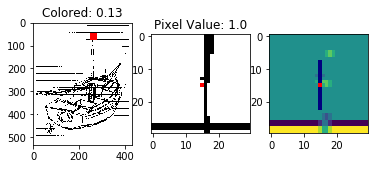

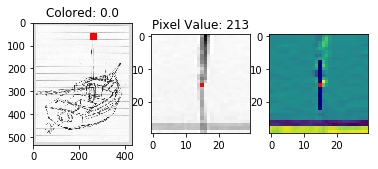

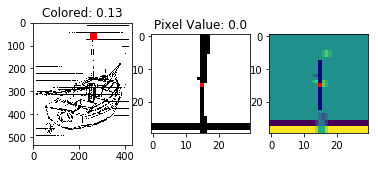

asdf
0


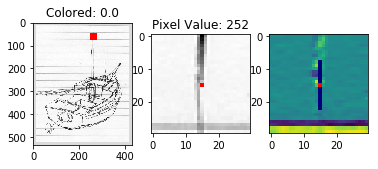

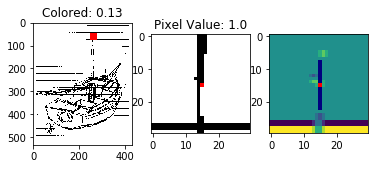

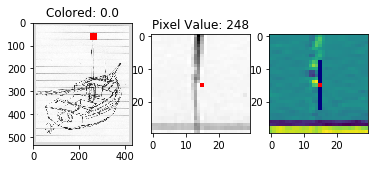

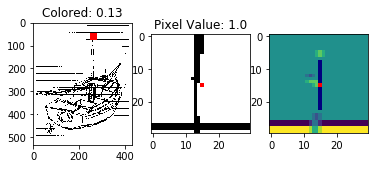

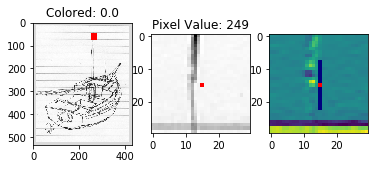

...

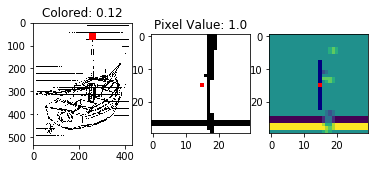

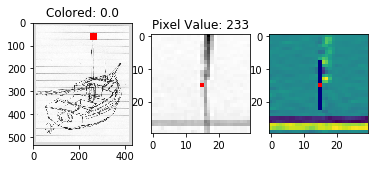

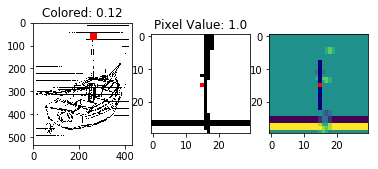

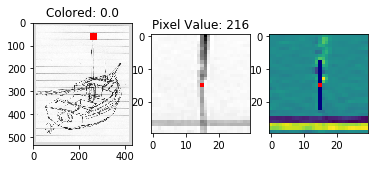

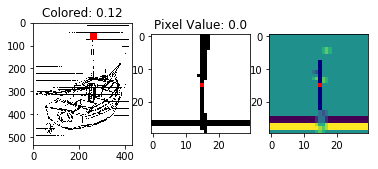

sdaf
0


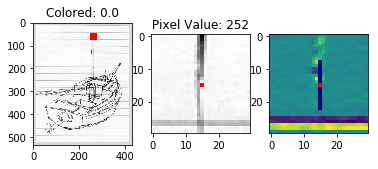

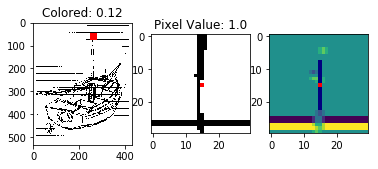

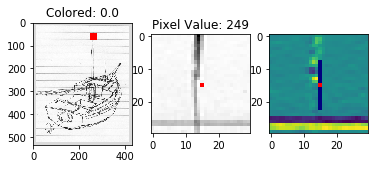

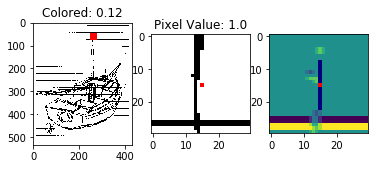

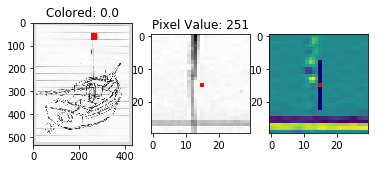

...

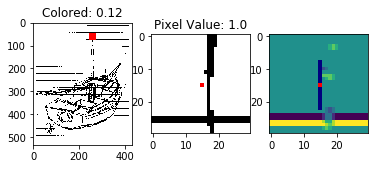

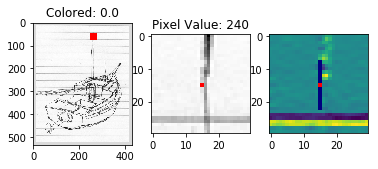

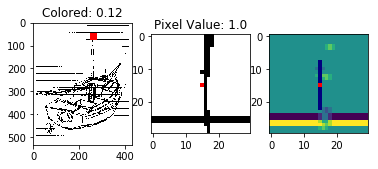

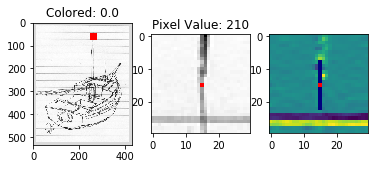

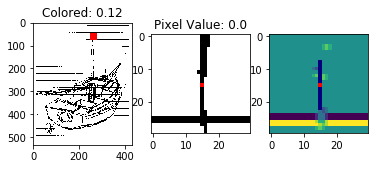

sdfa
0


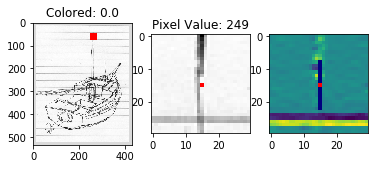

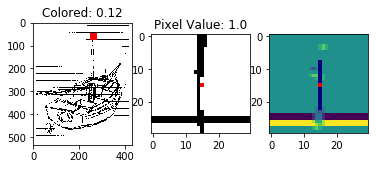

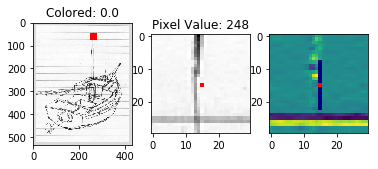

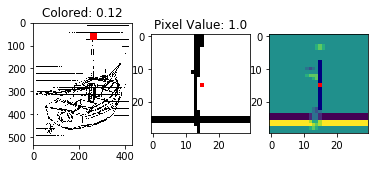

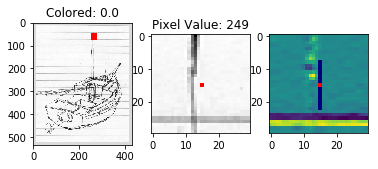

...

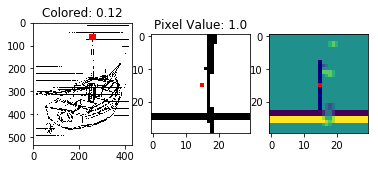

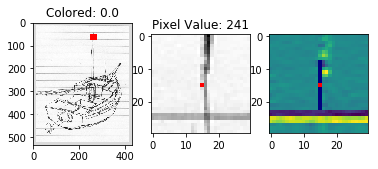

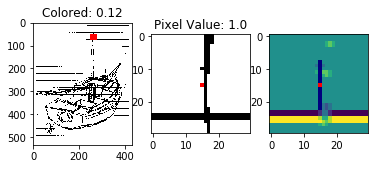

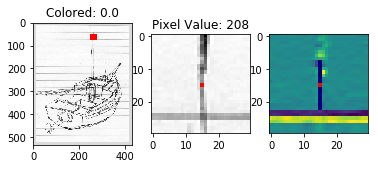

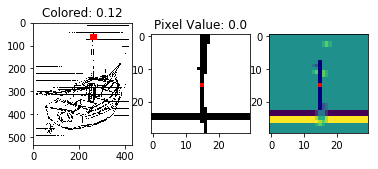

asdf
0


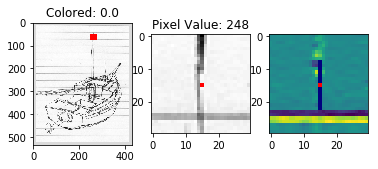

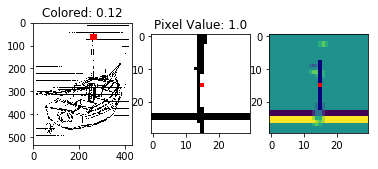

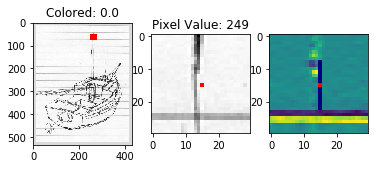

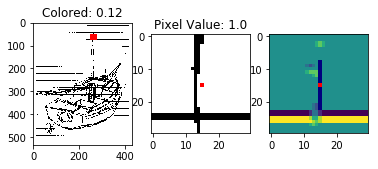

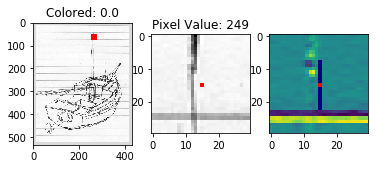

...

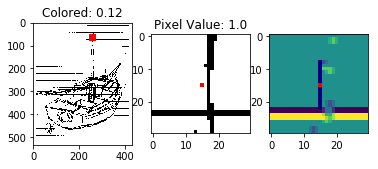

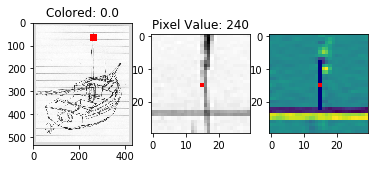

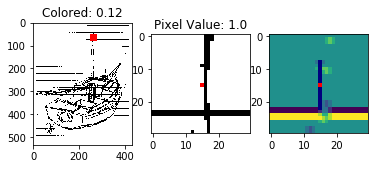

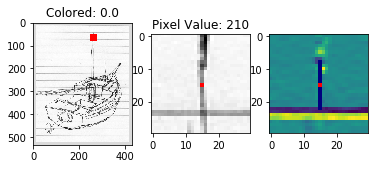

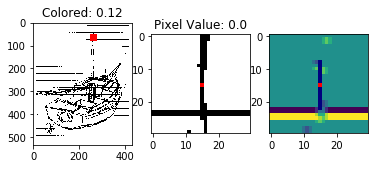

adsf
0


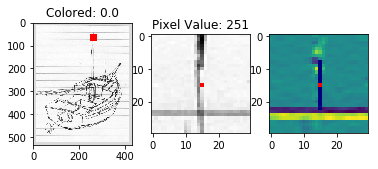

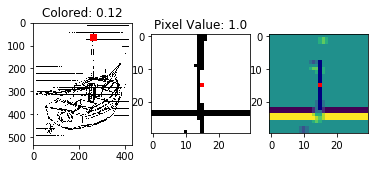

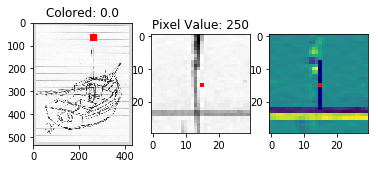

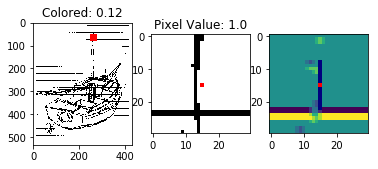

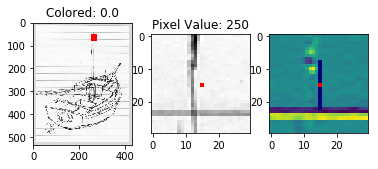

...

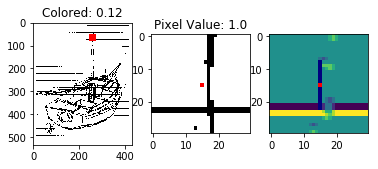

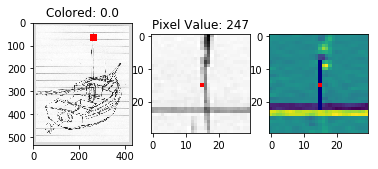

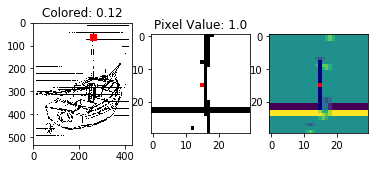

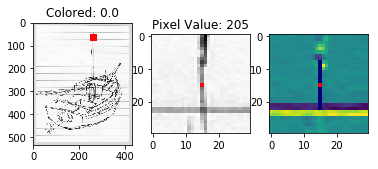

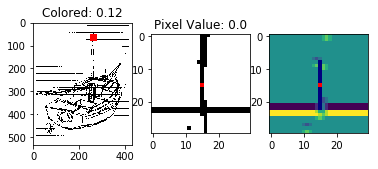

asdf
0


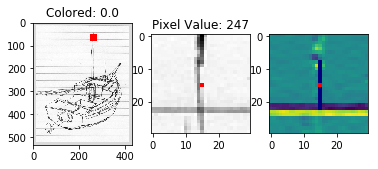

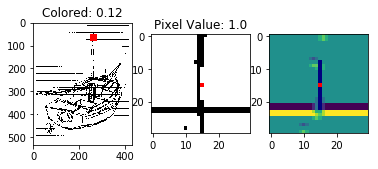

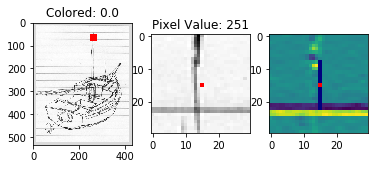

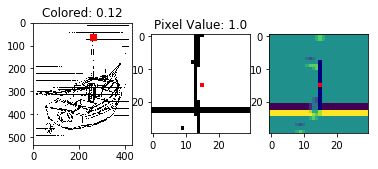

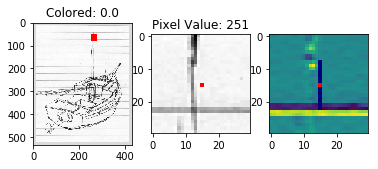

...

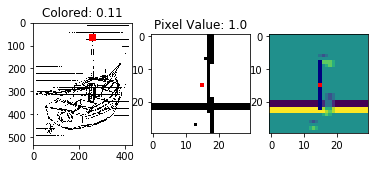

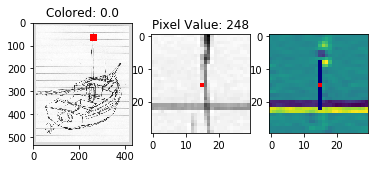

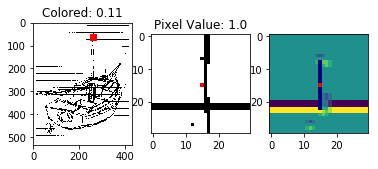

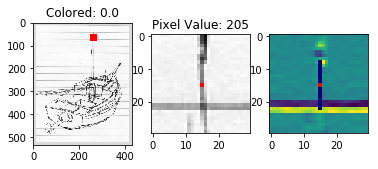

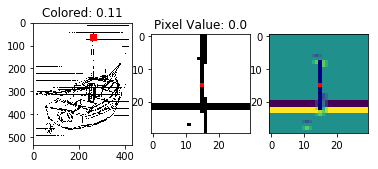

In [ ]:

images.gen_data(43)



In [13]:
def plot_frame(zoom, row_index, col_index, size):
    masked_window = np.random.random((zoom.shape[0],zoom.shape[1]))
    masked_window[row_index:row_index+size, col_index:col_index+size] = 1
    masked_window = np.ma.masked_where(masked_window != 1, masked_window)

    masked_pixel = np.random.random((zoom[row_index:row_index+size, col_index:col_index+size].shape[0],zoom[row_index:row_index+size, col_index:col_index+size].shape[1]))
    masked_pixel[15,15] = 1
    masked_pixel = np.ma.masked_where(masked_pixel != 1, masked_pixel)

    masked_pixel1 = np.random.random((zoom[row_index:row_index+size, col_index:col_index+size].shape[0],zoom[row_index:row_index+size, col_index:col_index+size].shape[1]))
    masked_pixel1[8:23, 15] = 1
    masked_pixel1 = np.ma.masked_where(masked_pixel1 != 1, masked_pixel1)
    
    window = zoom[row_index:row_index+size, col_index:col_index+size]
    colored_percentage = np.count_nonzero(window==0)/(30**2)
    pixel_value = window[15, 15]
    window_sobel = ndimage.sobel(window, axis=0)
    above_area = np.mean(window_sobel[8:16, 15])
    below_area = np.mean(window_sobel[16:23, 15])
    sobel_value = window_sobel[15, 15]
    
    # Overlay the two images
    fig, ax = plt.subplots(1, 3)
    ax.ravel()
    ax[0].imshow(zoom, cmap='gray')
    ax[0].imshow(masked_window, cmap='prism', interpolation='none')
    # ax[0].imshow(masked_pixel, cmap=cm.jet, interpolation='none')
    ax[0].set_title('Colored: {}'.format(round(colored_percentage, 2)))
    ax[1].imshow(window, cmap='gray')
    ax[1].imshow(masked_pixel, cmap='prism', interpolation='none')
    ax[1].set_title('Pixel Value: {}'.format(pixel_value))
    ax[2].imshow(window_sobel)
    ax[2].imshow(masked_pixel1, cmap='jet')
    ax[2].imshow(masked_pixel, cmap='prism', interpolation='none')
#     return above_area, below_area, colored_percentage


def get_label():
    label = input()
    if label == 'l':
        label_for_entry = 1
    elif label == '':
        label_for_entry = 1
    else:
        label_for_entry = 0
    return label_for_entry



def update_dict(my_dict, gray_pixel_value, mean_pixel_value, colored_percentage, sobel_gradient, label):
    my_dict['gray_pixel_value'].append(gray_pixel_value)
    my_dict['mean_gray_pixel_value'].append(mean_pixel_value)
    my_dict['bin_percentage_colored'].append(colored_percentage)
    my_dict['sobel_gradient'].append(sobel_gradient)
    my_dict['label'].append(label)
#     return my_dict

def add_label_history(df):
    df['label_t1'] = ""
    df['label_t2'] = ""
    df['label_t3'] = ""
    for idx, row in df.iterrows():
        if idx > 0:
            df.at[idx,'label_t1'] = list(df[df.index == idx - 1].label)[0]
            if idx > 1:
                df.at[idx,'label_t2'] = list(df[df.index == idx - 2].label)[0]
                if idx > 2:
                    df.at[idx,'label_t3'] = list(df[df.index == idx - 3].label)[0]

def gen_data(row):  
    my_dict = {'sobel_above': [], 'sobel_below': [], 'percentage_colored': [], 'label': []}
    for i in range(1, 900):
        size = 30
        row_index = row
        col_index = i
        plot_frame(zoom, row_index, col_index, size)
        plt.show()
        window = zoom[row_index:row_index+size, col_index:col_index+size]
        colored_percentage = np.count_nonzero(window==0)/(30**2)
        above_area = np.mean(window_sobel[8:16, 15])
        below_area = np.mean(window_sobel[16:23, 15])
        pixel_value = window[15, 15]
        if pixel_value == 0.0:
            label = get_label()
            update_dict(my_dict, above_area, below_area, colored_percentage, label)
    df = pd.DataFrame.from_dict(my_dict)
    add_label_history(df)
    return df

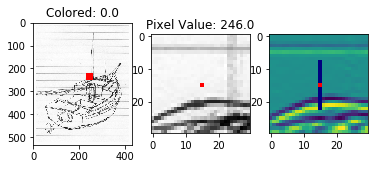

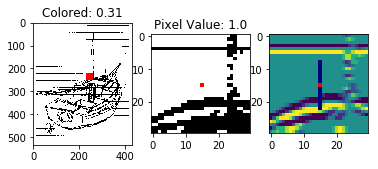

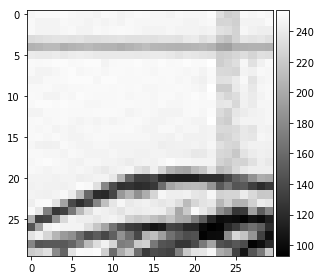

In [38]:
my_dict = {'gray_pixel_value': [], 'mean_gray_pixel_value': [], 'bin_percentage_colored': [], 'sobel_gradient': [], 'label': []}

size = 30
row_idx = 220

col_idx = 230
plot_frame(gray, row_idx, col_idx, size)
plot_frame(binar, row_idx, col_idx, size)
plt.show()
gray_window = gray[row_idx:row_idx+size, col_idx:col_idx+size]
io.imshow(gray_window, cmap='gray')
bin_window = binar[row_idx:row_idx+size, col_idx:col_idx+size]
gray_pixel_value = gray_window[15, 15]
bin_pixel_value = bin_window[15, 15]
mean_pixel_value = np.mean(gray_window)
gray_window_sobel = ndimage.sobel(gray_window, axis=0)
colored_percentage = np.count_nonzero(bin_window==0)/(30**2)
above_area = np.mean(gray_window_sobel[8:16, 15])
below_area = np.mean(gray_window_sobel[16:23, 15])
sobel_gradient = above_area - -below_area
# if bin_pixel_value == 0.0:
#     label = get_label()
#     update_dict(my_dict, gray_pixel_value, mean_pixel_value, colored_percentage, sobel_gradient, label)
            
            
# print(my_dict)
# io.imshow(bin_window, cmap='gray')


In [45]:
## Window EDA

In [40]:
gray_lines = glob.glob('../data/gray/all/lines/*')
gray_drawings = glob.glob('../data/gray/all/drawings/*')

In [41]:
images_array_D = []
for image in gray_drawings:
    images_array_D.append(imread(image, mode='L'))
images_array_D = np.array(images_array_D)

images_array = []
for image in gray_lines:
    images_array.append(imread(image, mode='L'))
images_array = np.array(images_array)

/Users/reiffd/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  This is separate from the ipykernel package so we can avoid doing imports until
/Users/reiffd/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:8: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  


In [42]:
average_pixel_line = np.zeros((30, 30))
for i in range(30):
    for j in range(30):
        average_pixel_line[i, j] = np.mean(images_array[:, i, j])

average_pixel_drawing = np.zeros((30, 30))
for i in range(30):
    for j in range(30):
        average_pixel_drawing[i, j] = np.mean(images_array_D[:, i, j])

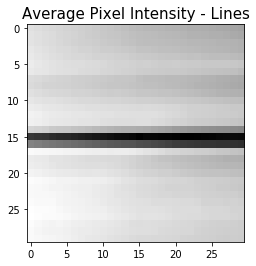

In [43]:
fig, ax = plt.subplots()
ax.imshow(average_pixel_line, cmap= 'gray')
ax.set_title('Average Pixel Intensity - Lines', fontsize=15)
fig.savefig('../data/after4.png')

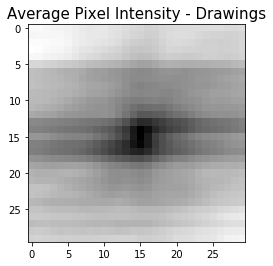

In [44]:
fig, ax = plt.subplots()
ax.imshow(average_pixel_drawing, cmap= 'gray')
ax.set_title('Average Pixel Intensity - Drawings', fontsize=15)
fig.savefig('../data/after4_draw.png')